### Imports

In [1]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import glob
from moviepy.editor import VideoFileClip


### Utility Functions

In [29]:
def bgr_to_rgb(image):
    b,g,r = cv2.split(image)
    return cv2.merge([r,g,b])

def compare_three_images(image1, image2, image3, cmap=None):
    f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(12, 9))
    f.tight_layout()
    ax1.imshow(image1, cmap=cmap)
    ax1.set_title('Original Image', fontsize=20)
    ax2.imshow(image2, cmap=cmap)
    ax2.set_title('Processed Image', fontsize=20)
    ax3.imshow(image3, cmap=cmap)
    ax3.set_title('Processed Image', fontsize=20)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.show()
    
def compare_images(image1, image2, cmap=None):
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(9, 6))
    f.tight_layout()
    ax1.imshow(image1, cmap=cmap)
    ax1.set_title('Original Image', fontsize=20)
    ax2.imshow(image2, cmap=cmap)
    ax2.set_title('Processed Image', fontsize=20)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.show()

def compare_first_stage_images(image1, image2, cmap=None):
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(9, 6))
    f.tight_layout()
    ax1.imshow(image1, cmap=cmap)
    ax1.set_title('Original Image', fontsize=20)
    ax2.imshow(image2, cmap='gray')
    ax2.set_title('Processed Image', fontsize=20)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.show()
def compare_prospective_images(image1, image2, src, dst, cmap=None):
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(image1, cmap=cmap)
    ax1.plot(src[0][0], src[0][1], '.')
    ax1.plot(src[1][0], src[1][1], '.')
    ax1.plot(src[2][0], src[2][1], '.')
    ax1.plot(src[3][0], src[3][1], '.')
    ax1.axvline(x=dst[0][0])
    ax1.axvline(x=dst[2][0])  
    ax1.plot(dst[0][0], dst[0][1], 'x')
    ax1.plot(dst[1][0], dst[1][1], 'x')
    ax1.plot(dst[2][0], dst[2][1], 'x')
    ax1.plot(dst[3][0], dst[3][1], 'x')
    ax1.set_title('Original Image', fontsize=50)
    ax2.imshow(image2, cmap=cmap)
    ax2.plot(src[0][0], src[0][1], '.')
    ax2.plot(src[1][0], src[1][1], '.')
    ax2.plot(src[2][0], src[2][1], '.')
    ax2.plot(src[3][0], src[3][1], '.')
    ax2.axvline(x=dst[0][0])
    ax2.axvline(x=dst[2][0])
    ax2.plot(dst[0][0], dst[0][1], 'x')
    ax2.plot(dst[1][0], dst[1][1], 'x')
    ax2.plot(dst[2][0], dst[2][1], 'x')
    ax2.plot(dst[3][0], dst[3][1], 'x')
    ax2.set_title('Processed Image', fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.show()

def plot_lane_histogram(image):
    histogram = np.sum(image[image.shape[0]//2:,:], axis=0)
    plt.plot(histogram)
    plt.show()

def compare_final_out(image1, image2, left_fitx, right_fitx, ploty):  
    plt.imshow(image1)
    plt.show()
    plt.imshow(image2)
    plt.plot(left_fitx, ploty, color='yellow')
    plt.plot(right_fitx, ploty, color='yellow')
    plt.xlim(0, 1280)
    plt.ylim(720, 0)
    plt.show()
    
def read_image_files(path):
    images = []
    image_files = glob.glob(path)
    #add some error checking
    for image_file in image_files:
        images.append(bgr_to_rgb(cv2.imread(image_file)))
    return images

def trap_area(deminsions):
    bt1 = np.float32(deminsions[0][0])
    bt2 = np.float32(deminsions[3][0])
    bb1 = np.float32(deminsions[1][0])
    bb2 = np.float32(deminsions[2][0])
    h1 = np.float32(deminsions[0][1])
    h2 = np.float32(deminsions[1][1])
    baset = abs(bt1-bt2)
    baseb = abs(bb1-bb2)
    height = abs(h1-h2)
    return ((baset + baseb)/2.0)*height +29

def rec_deminsions(rec_deminsions, trap_area):
    new_demin = np.copy(rec_deminsions)
    new_demin[0][0] = rec_deminsions[1][0]
    new_demin[3][0] = rec_deminsions[2][0]
    sq_width = abs(rec_deminsions[1][0] - rec_deminsions[2][0])
    sq_height = trap_area/sq_width
    new_demin[0][1] = int(new_demin[0][1] - sq_height)
    new_demin[3][1] = int(new_demin[3][1] - sq_height)
    return new_demin



### Project Globals

In [3]:
calibration_images = read_image_files('./camera_cal/calibration*.jpg')
test_images = read_image_files('./test_images/*.jpg')

src = np.float32([[716, 470],
                  [1009, 660],
                  [288, 660],
                  [567, 470]])

area = trap_area(src)
dst = rec_deminsions(src, area)


### Camera Calibration Functions

In [4]:
def calibrate_camera(nx=9, ny=6):
    objpoints = [] #3D points in real world space
    imgpoints = [] #2D points in image plane
    # Prepare object points like (0,0,0, (1,0,0), (2,0,0)....,(7,4,0)
    objp = np.zeros((nx*ny, 3), np.float32)
    objp[:,:2] = np.mgrid[0:nx,0:ny].T.reshape(-1,2)

    images = calibration_images
          
    gray_image = cv2.cvtColor(images[0], cv2.COLOR_BGR2GRAY)
    gray_shape = gray_image.shape[::-1]

    for image in images:
        gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
        ret, corners = cv2.findChessboardCorners(gray, (nx, ny), None)
        if ret == True:
            imgpoints.append(corners)
            objpoints.append(objp)
        else:
            print("Error detecting corners in image %s. Exiting" % image_file)
            ret = False
    return cv2.calibrateCamera(objpoints, imgpoints, gray_shape, None, None)

def undistort_image(image, mtx, dist):
    return cv2.undistort(image, mtx, dist, None, mtx)


### Camera Calibration Test

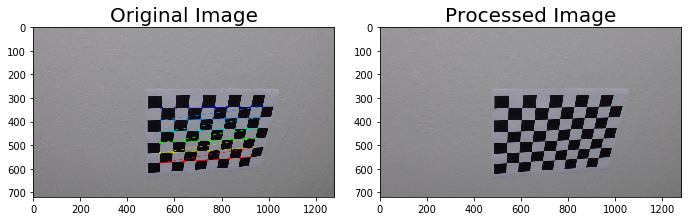

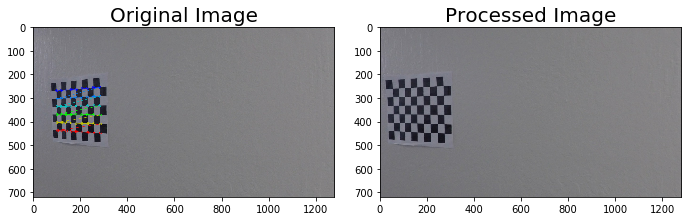

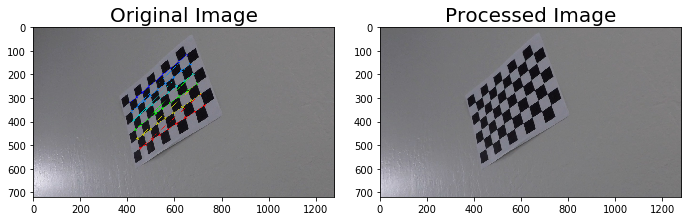

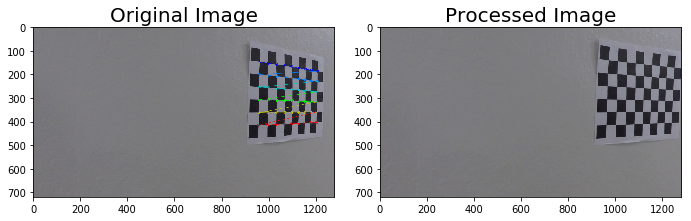

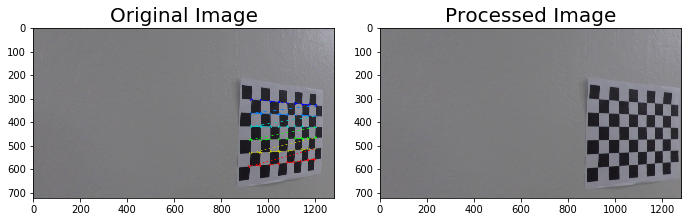

...

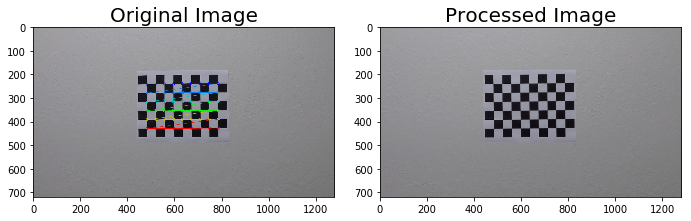

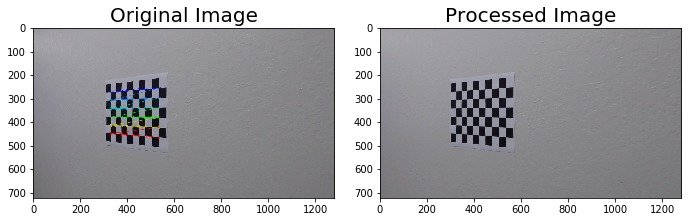

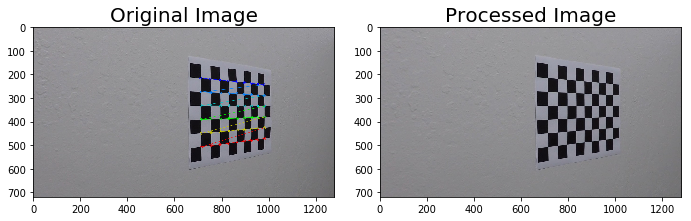

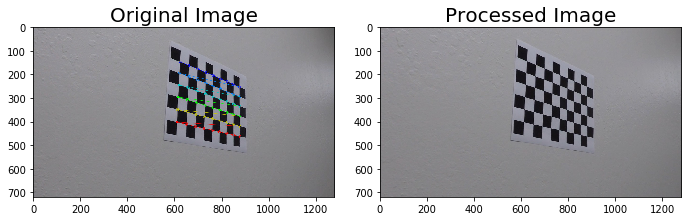

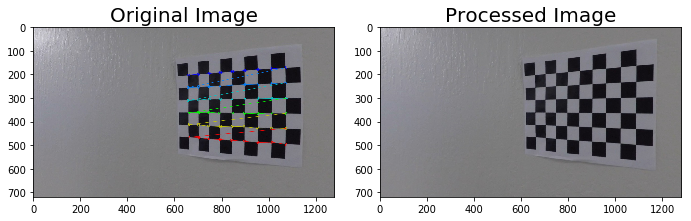

In [5]:
ret, mtx, dist, rvecs, tvecs = calibrate_camera(9, 6)
for index, calibration_image in enumerate(calibration_images):
    undist_image = undistort_image(calibration_image, mtx, dist)
    gray = cv2.cvtColor(calibration_image, cv2.COLOR_BGR2GRAY)
    ret, corners = cv2.findChessboardCorners(gray, (9, 6), None)
    calibration_image = cv2.drawChessboardCorners(calibration_image, (9,6), corners, ret)
    compare_images(calibration_image, undist_image)
    

### Sobel Filter

In [6]:
def abs_sobel_thresh(image, orient='x', thresh=(0,255)):
    gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    if orient == 'x':
        sobel = cv2.Sobel(gray, cv2.CV_64F, 1, 0)
    elif orient == 'y':
        sobel = cv2.Sobel(gray, cv2.CV_64F, 0, 1)
    else:
        print("bad orient passed")
        exit()
    abs_sobel = np.absolute(sobel)
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    sbinary = np.zeros_like(scaled_sobel)
    sbinary[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1
    return sbinary

### Sobel Test

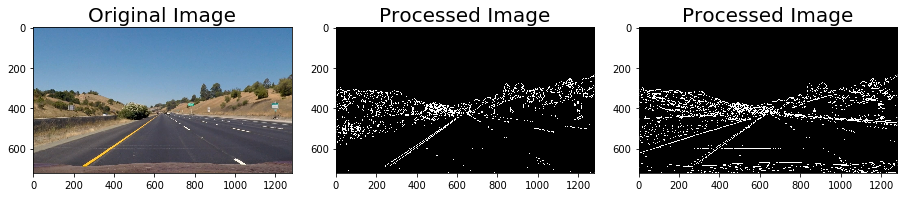

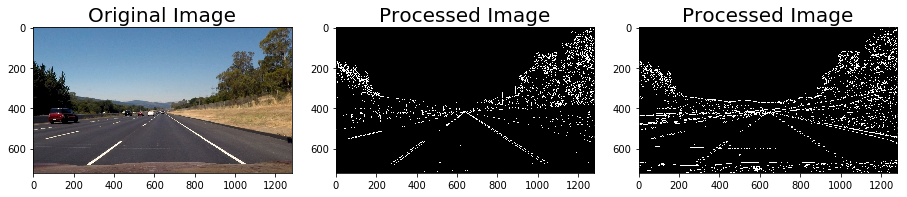

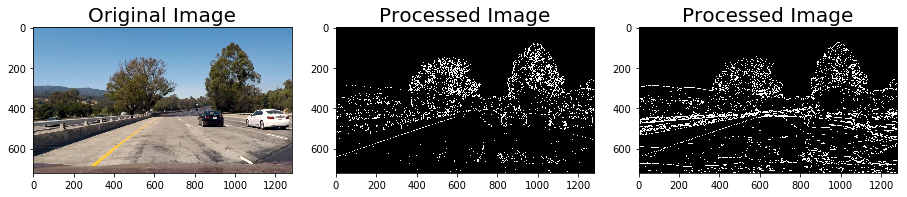

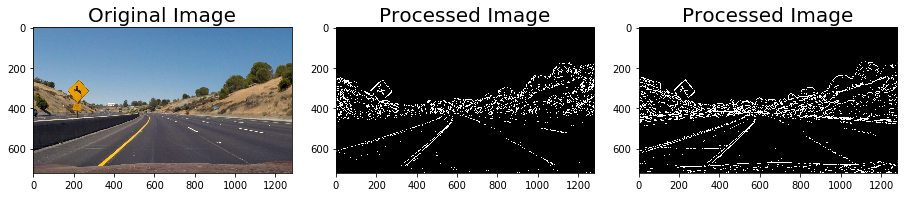

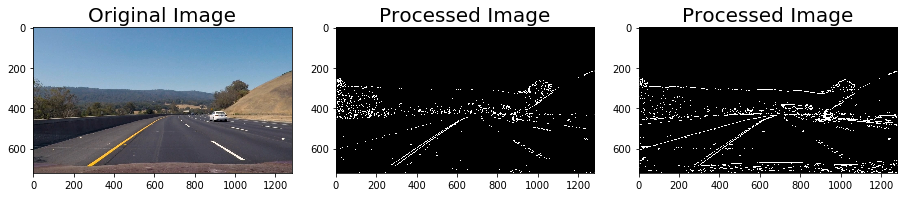

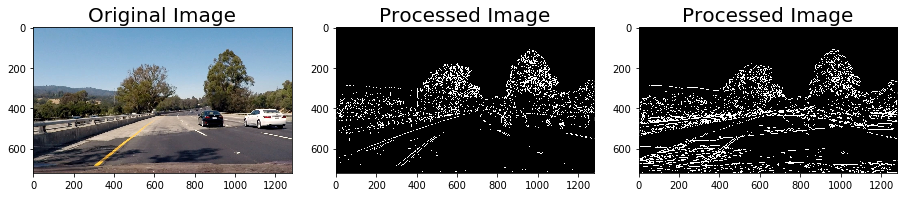

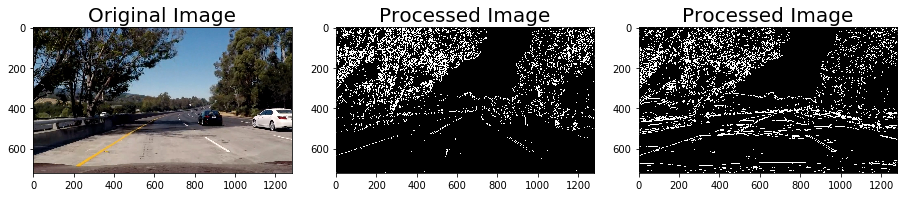

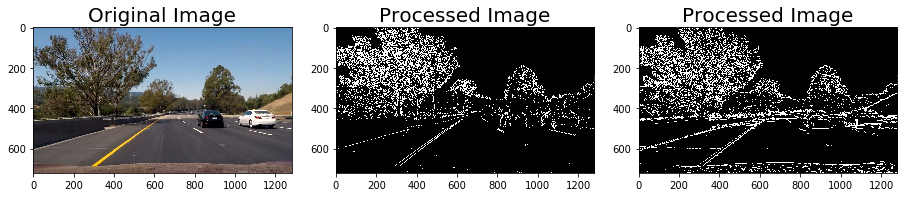

In [30]:
for image in test_images:
    xsobel = abs_sobel_thresh(image,'x', (20, 100))
    ysobel = abs_sobel_thresh(image,'y', (20, 100))
    compare_three_images(image, xsobel, ysobel, cmap='gray')

### Magnitude Threshold

In [8]:
def mag_thresh(img, sobel_kernel=3, mag_thresh=(0, 255)):
    
    # Apply the following steps to img
    # 1) Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # 2) Take the gradient in x and y separately
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # 3) Calculate the magnitude 
    gradmag = np.sqrt(sobelx**2 + sobely**2)
    # 4) Scale to 8-bit (0 - 255) and convert to type = np.uint8
    scale_factor = np.max(gradmag)/255 
    gradmag = (gradmag/scale_factor).astype(np.uint8) 
    # 5) Create a binary mask where mag thresholds are met
    binary_output = np.zeros_like(gradmag)
    binary_output[(gradmag >= mag_thresh[0]) & (gradmag <= mag_thresh[1])] = 1
    # 6) Return this mask as your binary_output image
    return binary_output

### Magnitude Threshold Test

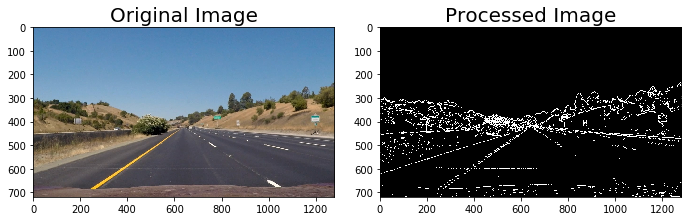

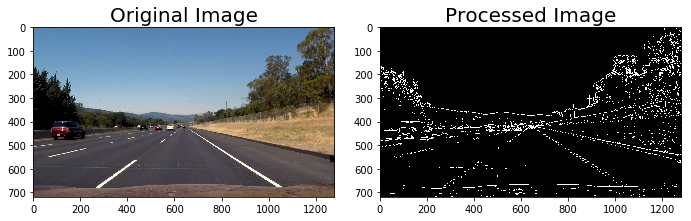

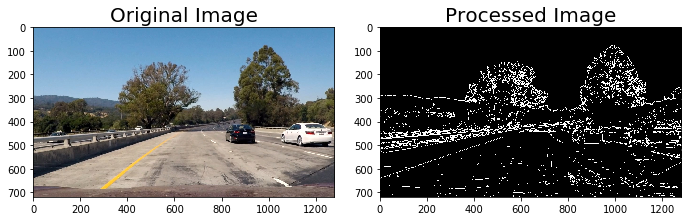

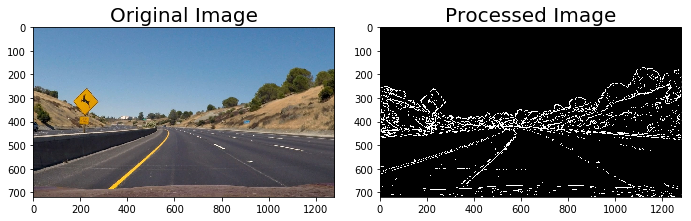

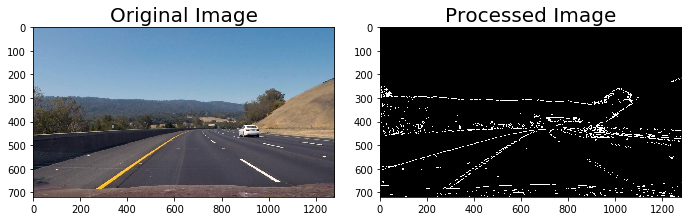

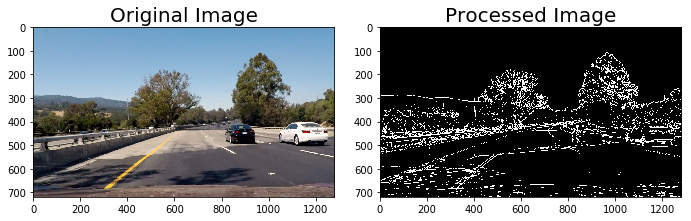

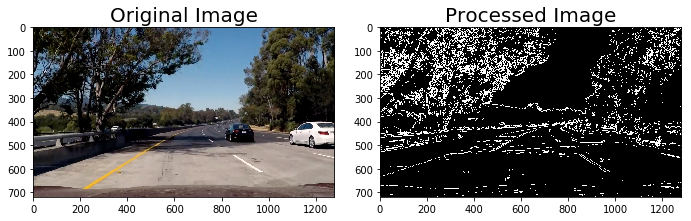

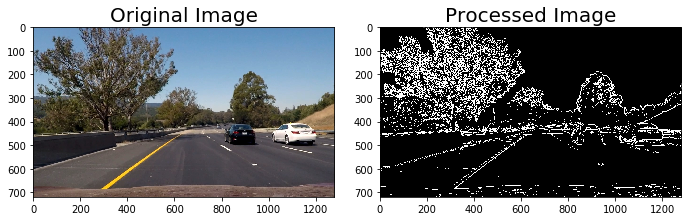

In [9]:
for image in test_images:
    new_image=mag_thresh(image,3,(30,100))
    compare_images(image, new_image, cmap='gray')

### Direction Threshold

In [10]:
def dir_threshold(img, sobel_kernel=3, thresh=(0, np.pi/2)):
    # Apply the following steps to img
    # 1) Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # 2) Take the gradient in x and y separately
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # 3) Take the absolute value of the x and y gradients
    abs_sobelx = np.absolute(sobelx)
    abs_sobely = np.absolute(sobely)
    # 4) Use np.arctan2(abs_sobely, abs_sobelx) to calculate the direction of the gradient
    direction = np.arctan2(abs_sobely, abs_sobelx)
    # 5) Create a binary mask where direction thresholds are met
    binary_output =  np.zeros_like(direction)
    binary_output[(direction >= thresh[0]) & (direction <= thresh[1])] = 1
    # 6) Return this mask as your binary_output image
    return binary_output

### Direction Threshold Test

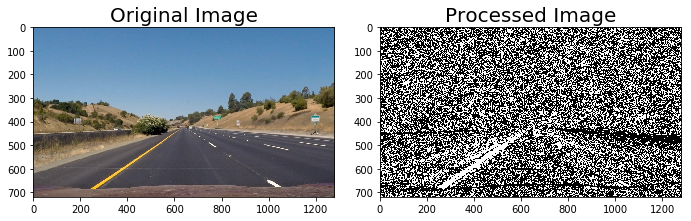

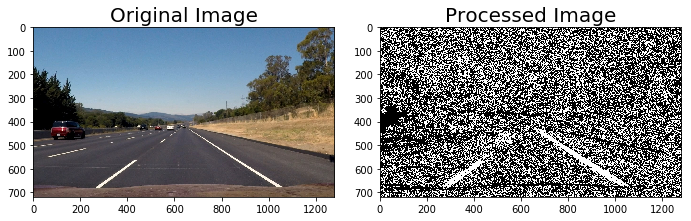

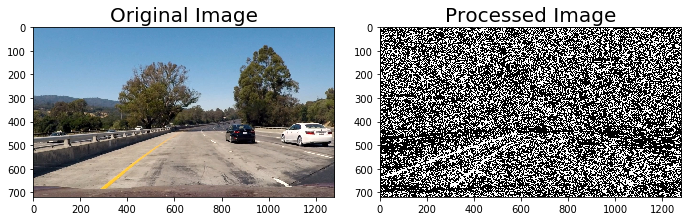

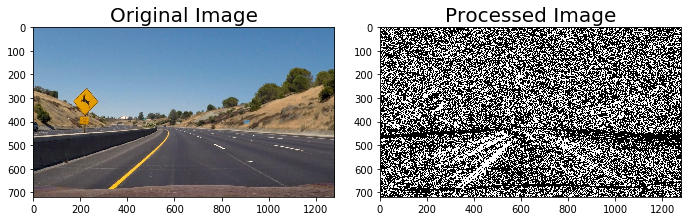

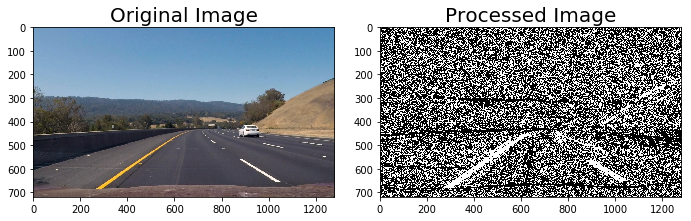

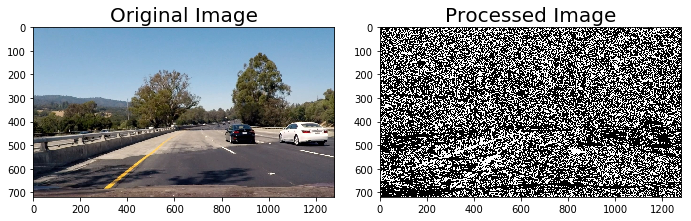

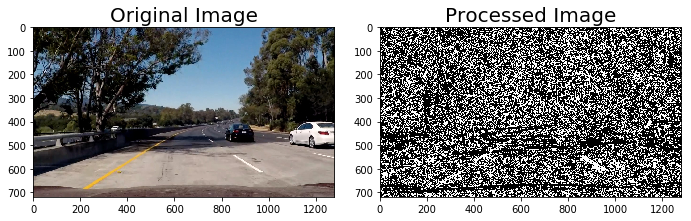

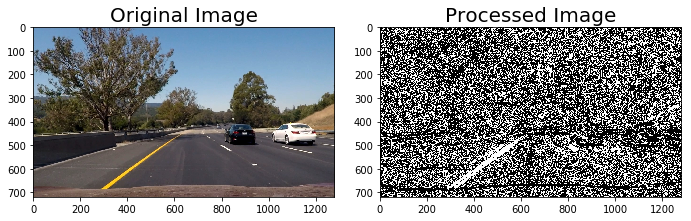

In [11]:
for image in test_images:
    new_image=dir_threshold(image, sobel_kernel=15, thresh=(0.7, 1.3))
    compare_images(image, new_image, cmap='gray')

### Color Threshold

In [12]:
def color_hls_threshold(image, channel='h', thresh=(0,255)):
    hls = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)
    H = hls[:,:,0]
    L = hls[:,:,1]
    S = hls[:,:,2]
    if channel == 'h':
        convert_channel = H
    elif channel == 'l':
        convert_channel = L
    elif channel == 's':
        convert_channel = S
    else:
        print("bad channel")
        exit()
    binary = np.zeros_like(convert_channel)
    binary[(convert_channel > thresh[0]) & (convert_channel <= thresh[1])] = 1
    return binary

def color_rgb_threshold(image, channel='r', thresh=(0,255)):
    R = image[:,:,0]
    G = image[:,:,1]
    B = image[:,:,2]
    if channel == 'r':
        convert_channel = R
    elif channel == 'G':
        convert_channel = G
    elif channel == 'b':
        convert_channel = b
    else:
        print("bad channel")
        exit()
    binary = np.zeros_like(convert_channel)
    binary[(convert_channel > thresh[0]) & (convert_channel <= thresh[1])] = 1
    return binary

### Color Threshold Test

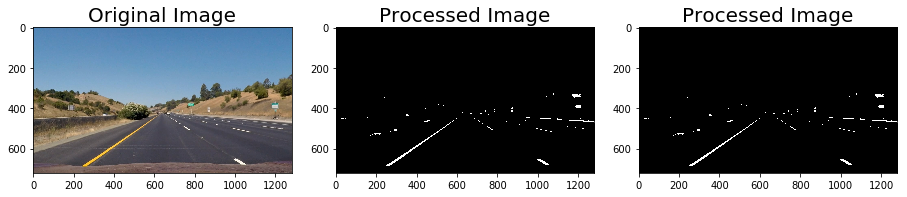

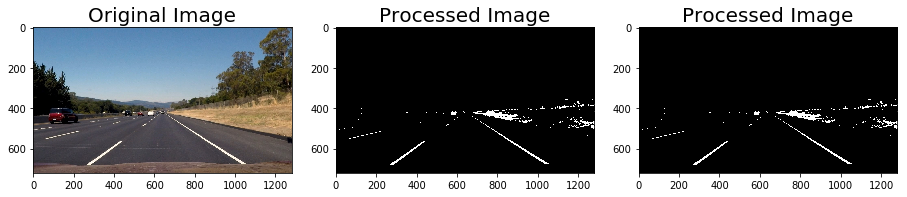

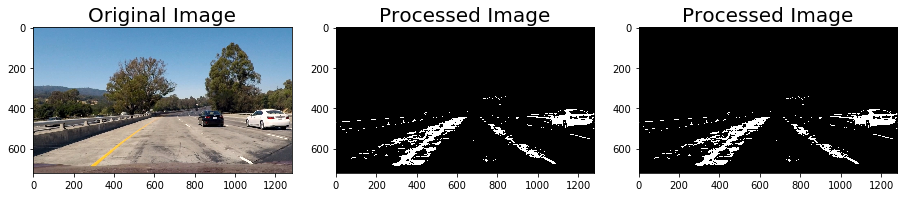

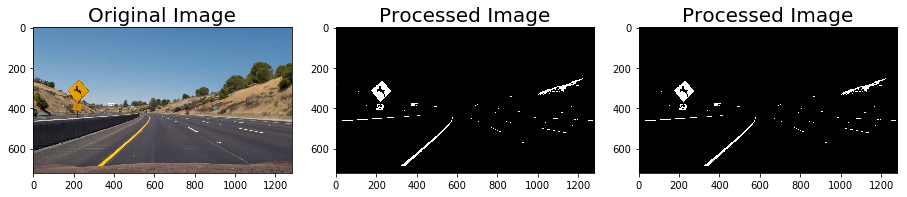

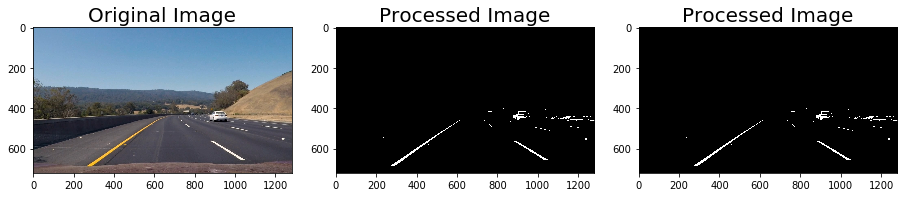

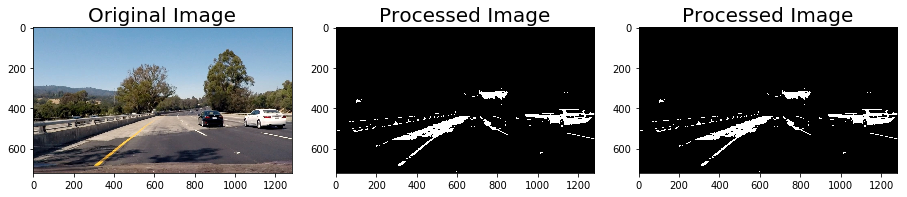

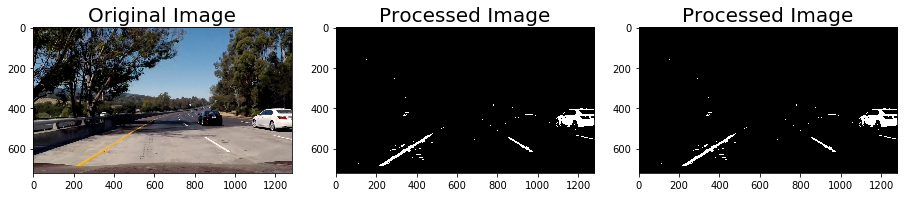

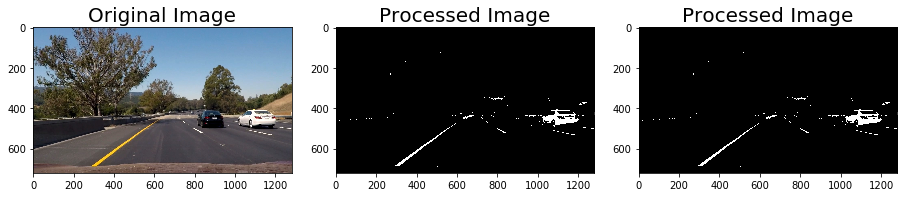

In [13]:
for image in test_images:
    r =  color_rgb_threshold(image, channel='r', thresh=(200,255))
    s =  color_hls_threshold(image, channel='s', thresh=(90,200))
    compare_three_images(image,r,s, cmap='gray')

### Combined Thresholds

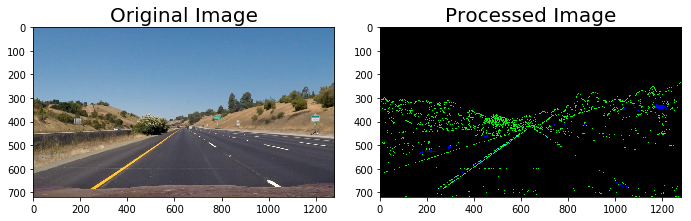

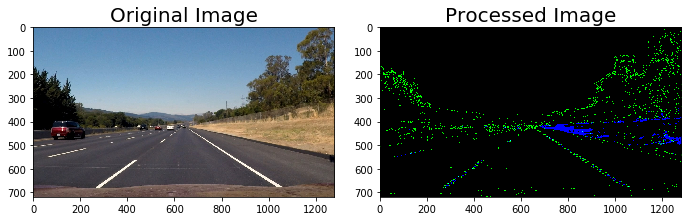

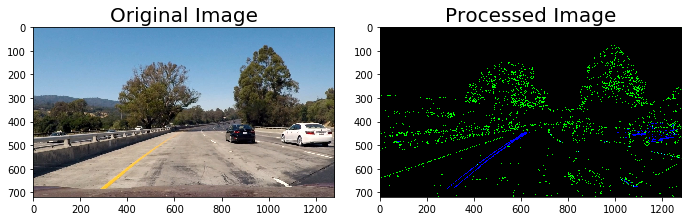

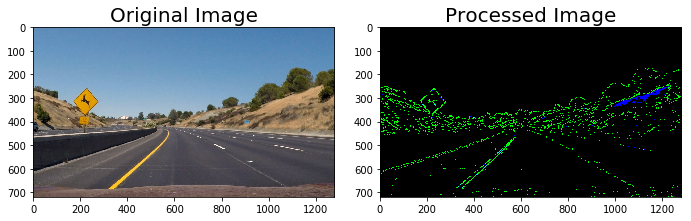

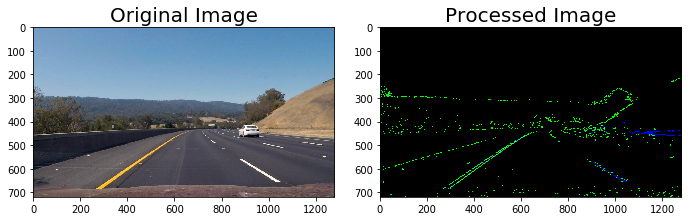

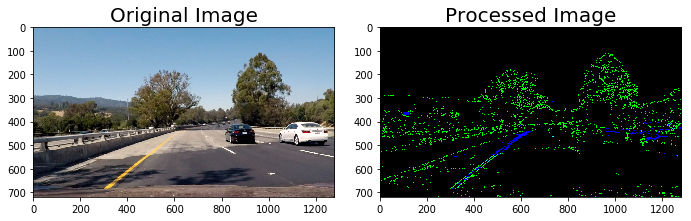

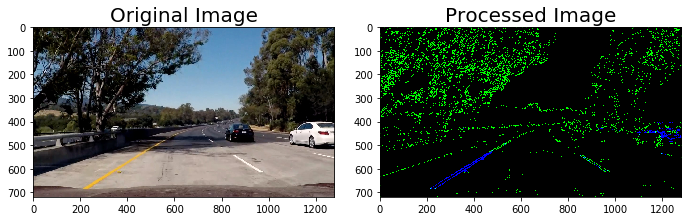

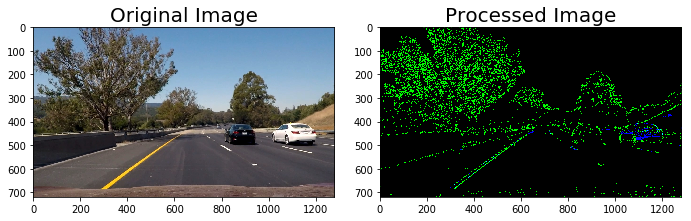

In [14]:
for image in test_images:
    xsobel = abs_sobel_thresh(image,'x', (20, 100))
    ysobel = abs_sobel_thresh(image,'y', (20, 100))
    magthresh = mag_thresh(image,3, (30, 100))
    dirthresh = dir_threshold(image, sobel_kernel=15, thresh=(0.7, 1.3))
    combined = np.zeros_like(dirthresh)
    combined[((xsobel == 1) & (ysobel == 1)) | ((magthresh == 1) & (dirthresh == 1))] = 1
    r =  color_rgb_threshold(image, channel='r', thresh=(200,255))
    s =  color_hls_threshold(image, channel='s', thresh=(90,200))
    
    color_combined =np.zeros_like(r)
    color_combined[(r == 1) & (s == 1)] = 1
    color_binary = np.dstack(( np.zeros_like(combined), combined, color_combined))
    compare_images(image, color_binary)

### Prospective Transform

In [15]:
def prospective_transform(image, src, dst):
    img_size = (image.shape[1], image.shape[0])
    M = cv2.getPerspectiveTransform(src, dst)
    warped = cv2.warpPerspective(image, M, img_size, flags=cv2.INTER_LINEAR)
    return warped

### Prospective Transform Test

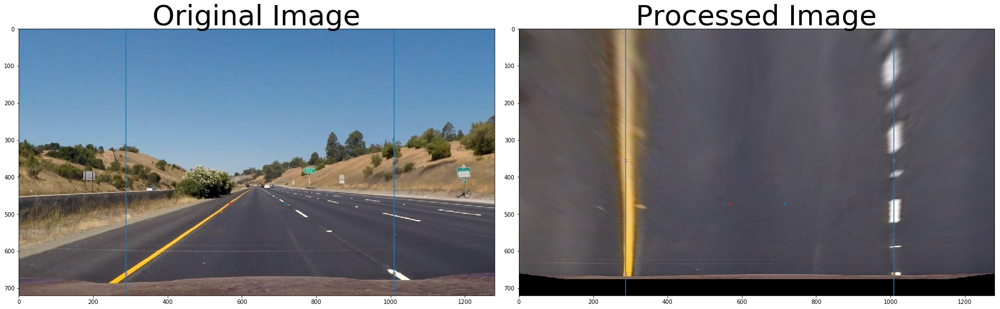

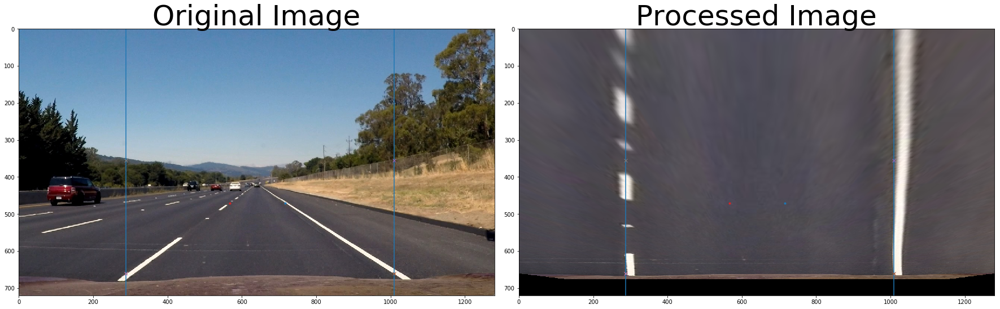

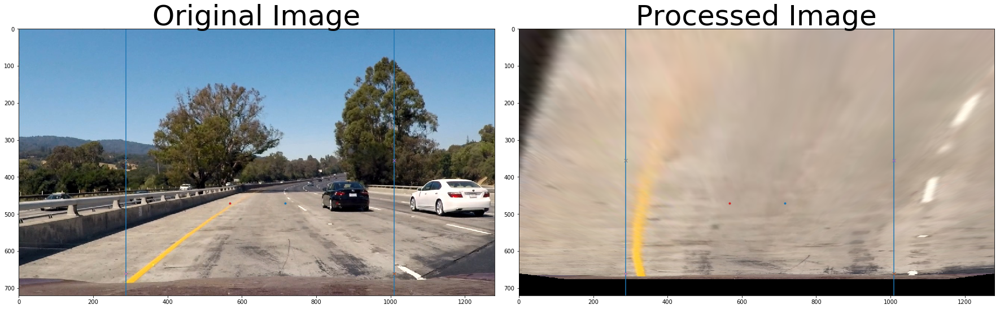

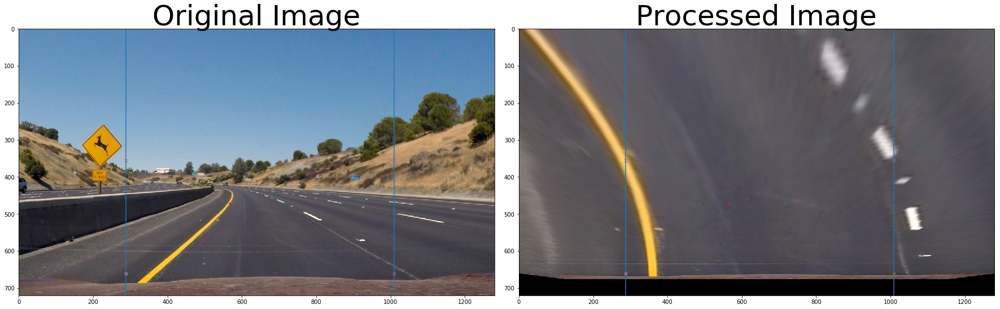

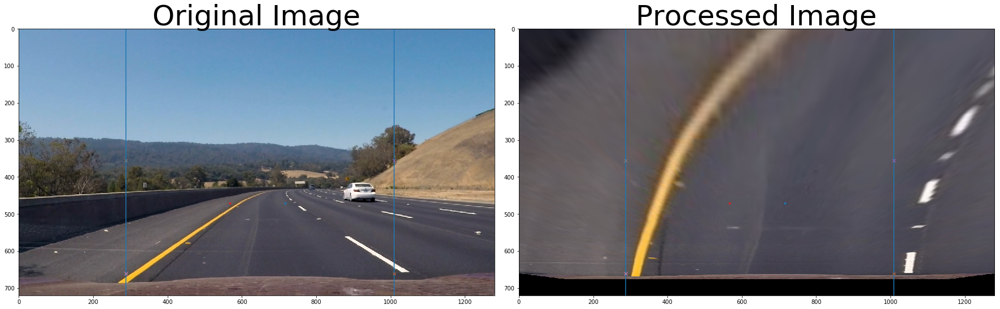

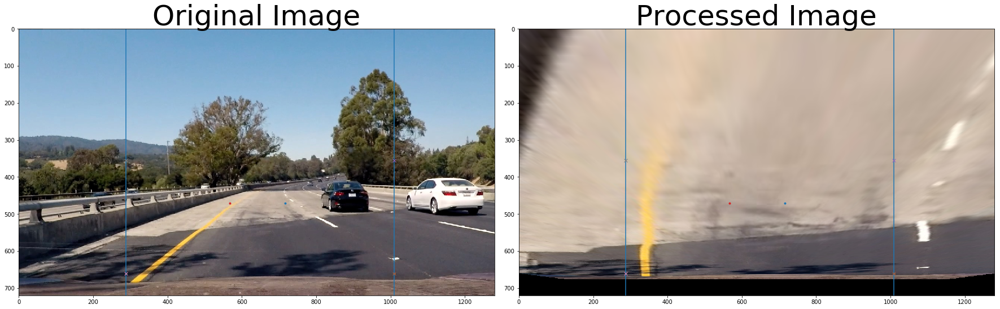

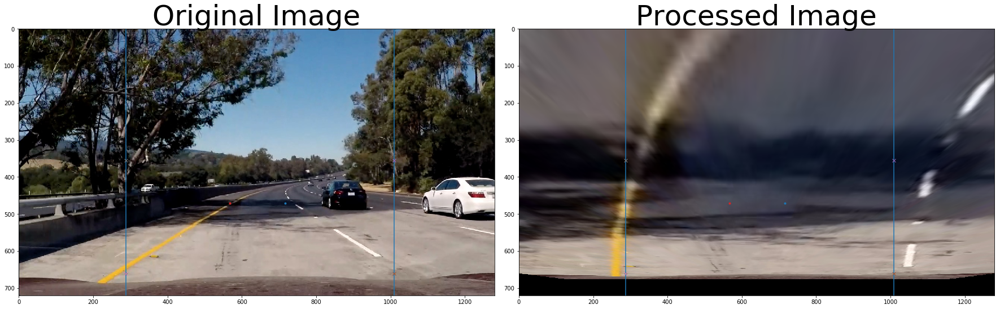

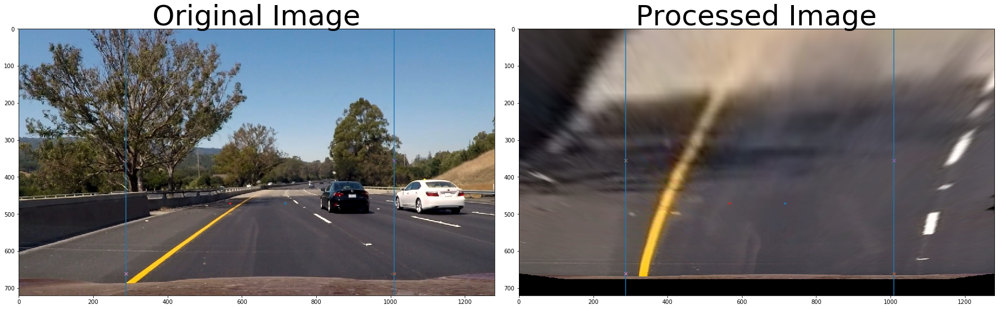

In [16]:
for image in test_images:
    new_image=prospective_transform(image, src, dst)  
    compare_prospective_images(image, new_image, src, dst)

### First Stage Pipeline



In [17]:
def first_stage_pipeline(image, mtx, dist, src, dst, area):
    new_image = cv2.undistort(image, mtx, dist, None, mtx)
    xsobel = abs_sobel_thresh(new_image,'x', (20, 100))
    ysobel = abs_sobel_thresh(new_image,'y', (20, 100))
    magthresh =  mag_thresh(new_image,3, (30, 100))
    dirthresh = dir_threshold(new_image, sobel_kernel=15, thresh=(0.7, 1.3))
    
    combined = np.zeros_like(dirthresh)
    combined[((xsobel == 1) & (ysobel == 1)) | ((magthresh == 1) & (dirthresh == 1))] = 1
    
    r =  color_rgb_threshold(new_image, channel='r', thresh=(200,255))
    s =  color_hls_threshold(new_image, channel='s', thresh=(90,200))
    
    color_combined =np.zeros_like(r)
    color_combined[(r == 1) & (s == 1)] = 1
    
    combined_binary = np.zeros_like(color_combined)
    combined_binary[(color_combined == 1) | (combined == 1)] = 1
    combined_binary = prospective_transform(combined_binary, src, dst)
    return combined_binary

### Test First Stage Pipeline

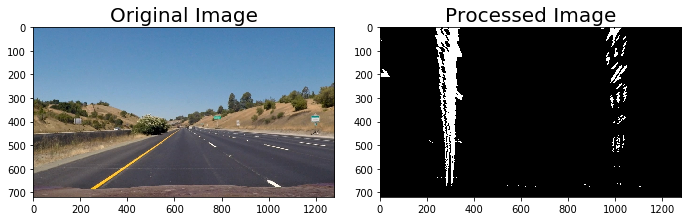

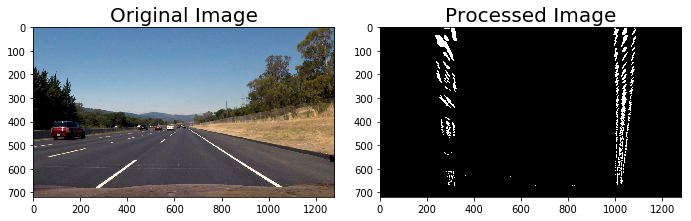

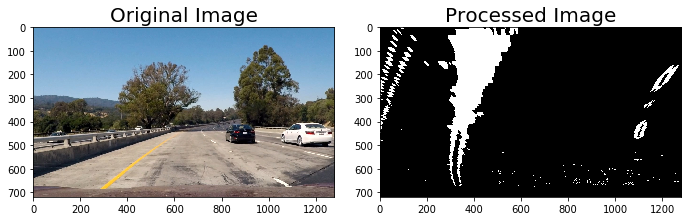

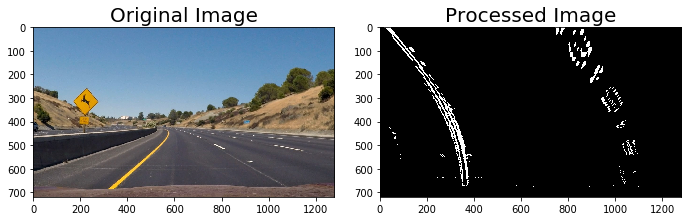

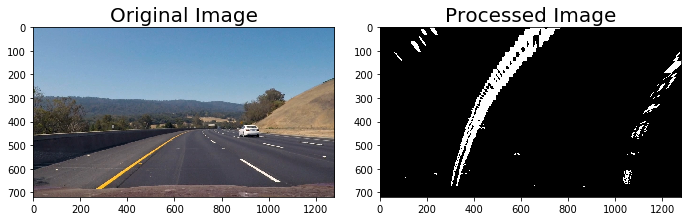

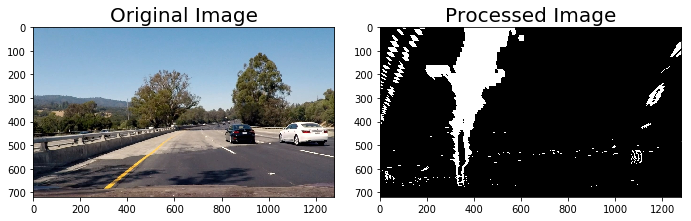

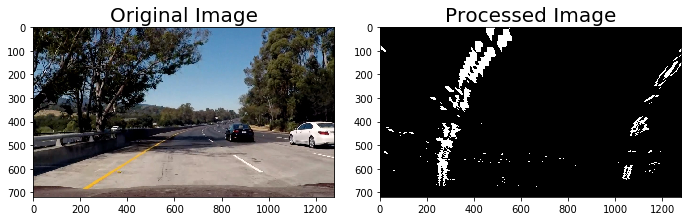

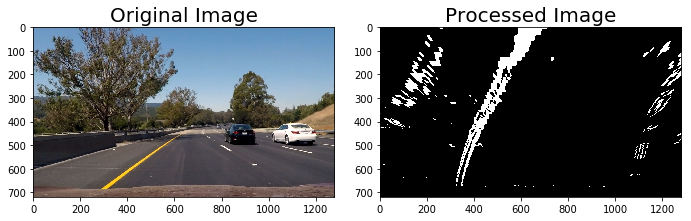

In [18]:
for image in test_images:
    new_image = first_stage_pipeline(image, mtx, dist, src, dst, area)
    compare_first_stage_images(image, new_image)
    

### Find Line Fits

In [19]:
def find_line_fits(binary_warped):
    # Assuming you have created a warped binary image called "binary_warped"
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
    # Create an output image to draw on and  visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]/2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint
    
    # Choose the number of sliding windows
    nwindows = 9
    # Set height of windows
    window_height = np.int(binary_warped.shape[0]/nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []
    left_lane_center = []
    right_lane_center = []
    
    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 2) 
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
            left_lane_center.append(leftx_current) 
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))
            right_lane_center.append(rightx_current)
            

                # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)
    

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 
    
    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)

    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
    
      
    return out_img, left_fitx, right_fitx, ploty, left_lane_center, right_lane_center

### Test First Stage and Find Lane Fit

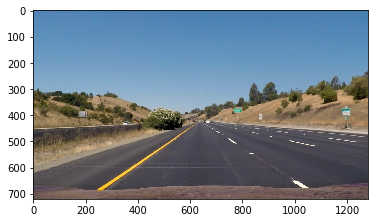

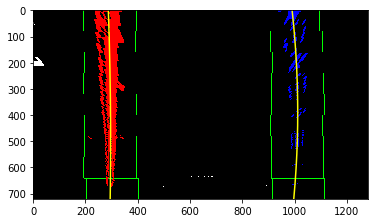

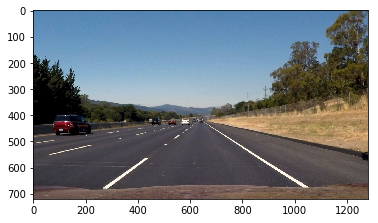

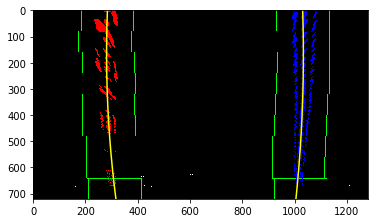

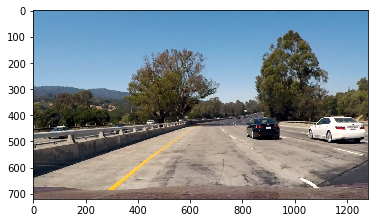

...

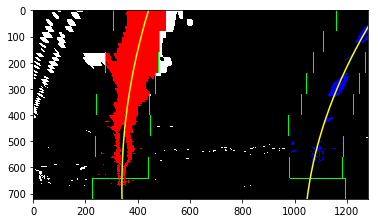

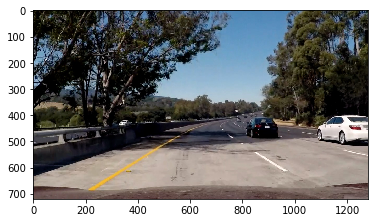

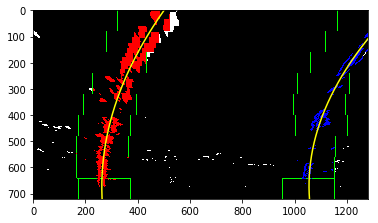

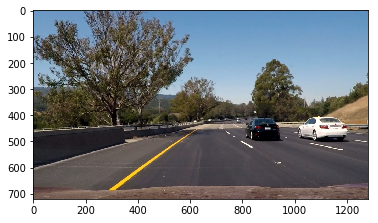

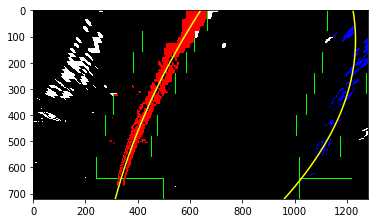

In [20]:
for image in test_images:
    new_image = first_stage_pipeline(image, mtx, dist, src, dst, area)
    out_img, left_fitx, right_fitx, ploty, left_center, right_center = find_line_fits(new_image)
    compare_final_out(image, out_img, left_fitx, right_fitx, ploty)


### Histogram of line location

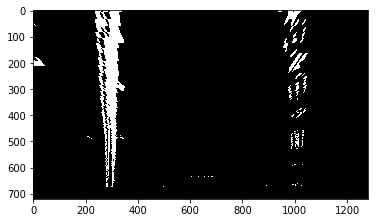

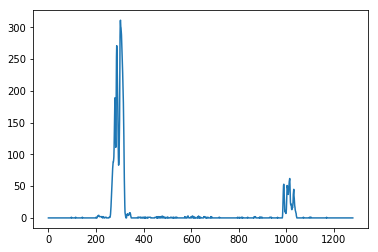

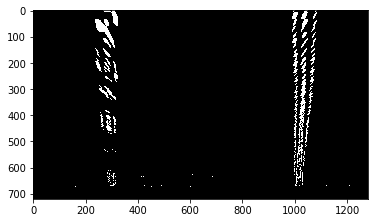

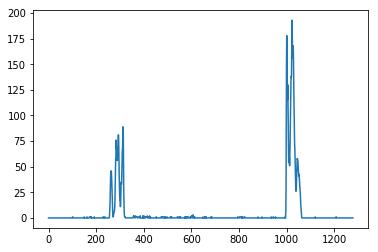

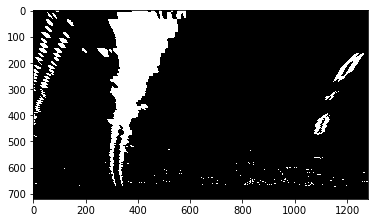

...

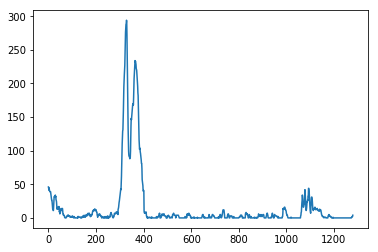

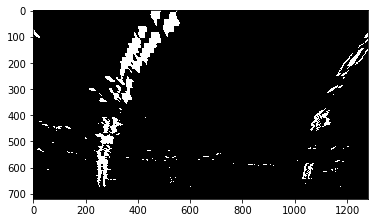

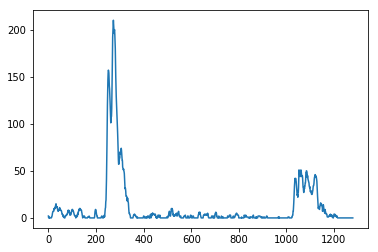

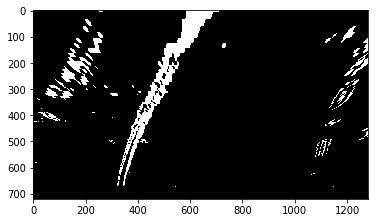

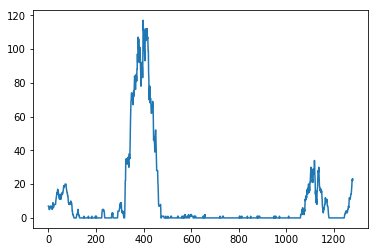

In [21]:
for image in test_images:
    new_image = first_stage_pipeline(image, mtx, dist, src, dst, area)
    out_img, left_fitx, right_fitx, ploty, left_center, right_center = find_line_fits(new_image)
    plt.imshow(new_image, cmap='gray')
    plt.show()
    plot_lane_histogram(new_image)
    

### Find Distance from center

In [22]:
def find_distance_from_center(image, left_center, right_center):
    x_width = image.shape[1]
    camera_center = x_width/2
    left_lane_location = left_center[0]
    right_lane_location = right_center[0]
    lane_center = (right_lane_location - left_lane_location)/2 + left_lane_location
    #conversion of pixels per meter = 3.7/700
    num_pixel_off_center = abs(lane_center - camera_center) * (3.7/700)
    return num_pixel_off_center

### Find Radius

In [23]:
def radius_of_curve(ploty, leftx, rightx):
    
    
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    
    y_eval = np.max(ploty)
    # Fit new polynomials to x,y in world space
    left_fit_cr = np.polyfit(ploty*ym_per_pix, leftx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(ploty*ym_per_pix, rightx*xm_per_pix, 2)
    # Calculate the new radii of curvature
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    return left_curverad, right_curverad

### Project Lane Lines

In [24]:
def project_results(image, warped, ploty, left_fitx, right_fitx):
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))
    
    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))
    M = cv2.getPerspectiveTransform(dst, src)
    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, M, (image.shape[1], image.shape[0])) 
    #newwarp = prospective_transform(color_warp, dst, src)
    # Combine the result with the original image
    result = cv2.addWeighted(image, 1, newwarp, 0.3, 0)
    return result

### Second Stage Pipeline

In [25]:
def second_stage_pipeline(image, pipe_image, left_fitx, right_fitx, ploty, left_center, right_center):
    distance_off_center = find_distance_from_center(pipe_image, left_center, right_center)
    left_radius, right_radius = radius_of_curve(ploty,left_fitx,right_fitx)
    new_image = project_results(image, pipe_image, ploty, left_fitx, right_fitx)
    font = cv2.FONT_HERSHEY_SIMPLEX
    cv2.putText(new_image,'Offset: %f m' %(distance_off_center) ,(10,100), font, 1,(255,255,255),2)
    cv2.putText(new_image,'L Curve: %.2f m' %(left_radius) ,(10,150), font, 1,(255,255,255),2)
    cv2.putText(new_image,'R Curve: %.2f m' %(right_radius) ,(10,200), font, 1,(255,255,255),2)
    return new_image

### Test Second Stage Pipeline

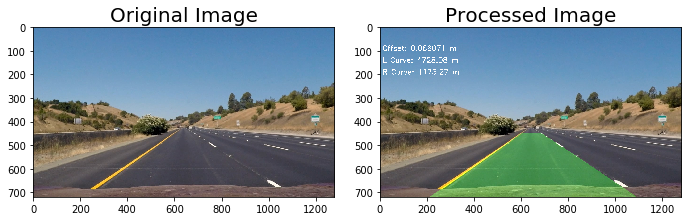

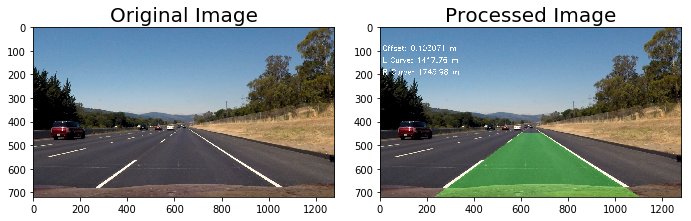

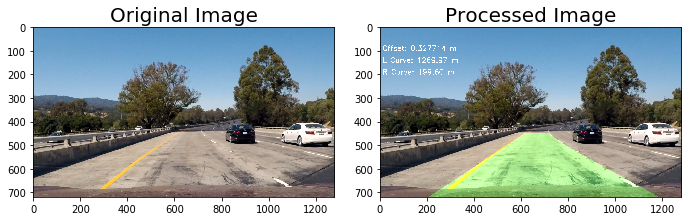

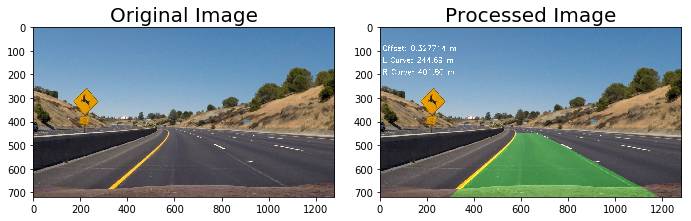

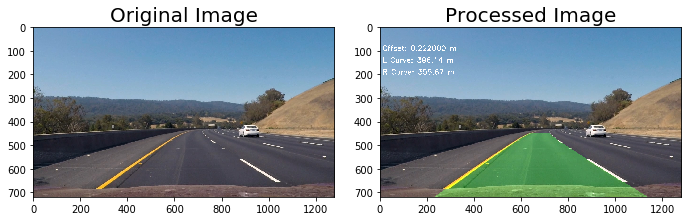

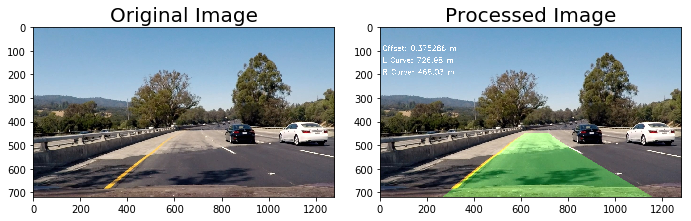

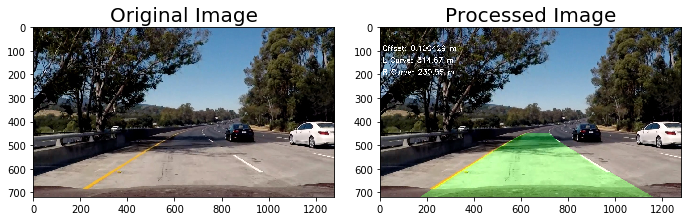

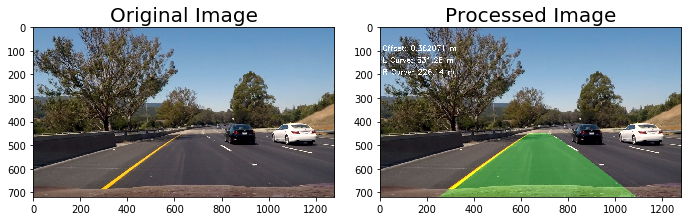

In [26]:
for image in test_images:
    new_image = first_stage_pipeline(image, mtx, dist, src, dst, area)
    binary_warped, left_fitx, right_fitx, ploty, left_center, right_center = find_line_fits(new_image)
    overlay = second_stage_pipeline(image, new_image,left_fitx, right_fitx, ploty, left_center, right_center)
    compare_images(image, overlay)

In [27]:
def process_image(image):
    new_image = first_stage_pipeline(image, mtx, dist, src, dst, area)
    binary_warped, left_fitx, right_fitx, ploty, left_center, right_center = find_line_fits(new_image)
    return second_stage_pipeline(image, new_image,left_fitx, right_fitx, ploty, left_center, right_center)
    

In [31]:
vid_output = 'project_video_out.mp4'
clip = VideoFileClip('project_video.mp4')
vid_clip = clip.fl_image(process_image)
%time vid_clip.write_videofile(vid_output, audio=False)

[MoviePy] >>>> Building video project_video_out.mp4
[MoviePy] Writing video project_video_out.mp4


100%|█████████▉| 1260/1261 [05:14<00:00,  4.08it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: project_video_out.mp4 

CPU times: user 11min 9s, sys: 1.99 s, total: 11min 11s
Wall time: 5min 14s
